# DCGAN example  for celibrity face generation

- DCGAN: Deep Convolutional GAN
- Originally created by Sanmay
- I just did some clean up and minor tweaking

In [1]:
from __future__ import print_function
import random
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# import dset to use
import torchvision.datasets as dset

## Setting a seed to random number generator for reproducibility of results

In [2]:
# Set random seem for reproducibility
manualSeed = 999
print("Random Seed: ", manualSeed)

random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


# Download the dataset
    
- Original dataset [here](https://www.kaggle.com/datasets/jessicali9530/celeba-dataset)
- The dropbox link has 10k randomly picked example from the original dataset

In [3]:
!wget https://www.dropbox.com/s/gy4orfg608l4u9z/celebA_10k.zip
!unzip -q celebA_10k.zip

--2025-04-23 21:20:13--  https://www.dropbox.com/s/gy4orfg608l4u9z/celebA_10k.zip
Resolving www.dropbox.com (www.dropbox.com)... 162.125.1.18, 2620:100:6017:18::a27d:212
Connecting to www.dropbox.com (www.dropbox.com)|162.125.1.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://www.dropbox.com/scl/fi/8v1ybpr1otipjuewm93kw/celebA_10k.zip?rlkey=40b4u0r39xarcrk0otrceo2jp [following]
--2025-04-23 21:20:14--  https://www.dropbox.com/scl/fi/8v1ybpr1otipjuewm93kw/celebA_10k.zip?rlkey=40b4u0r39xarcrk0otrceo2jp
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uca390d53ca92eec8103ec3dee92.dl-eu.dropboxusercontent.com/cd/0/inline/CoZNmsomGN8OBFZxzn_StaVV4DUXLYfJn7BOhGi2g3ROvo9n25XKfB00rfJxvKKhMA0-PRlJ4tbyPpsar-Ac-O5n-ap3vx2xUUsqUYlfWfxU7Z356cYsVXdnUC5KVVYRZsHgtrO0uYWUeI7ovTCAJa5G/file# [following]
--2025-04-23 21:20:14--  https://uca390d53ca92eec8103ec3dee92.dl-eu.dropboxusercontent.com/c

### Making a subdirectory `celebA` and putting the images there
    - `torchvision.datasets.ImageFolder` expects you to put all the images of the same classes to be in the same folder
        - All dog images in the `root/dog` folder, all the cat images in the `root/cat` folder
    - We just have one class, so we call it `celebA` class, and we put everything there

In [4]:
!mv celebA_10k celebA
!mkdir celebA_10k
!mv celebA celebA_10k/

### Torchvision
    - torchvision comes with a bunch of utilites that are helpful.
    - Let's use `ImageFolder`
        - https://pytorch.org/vision/stable/generated/torchvision.datasets.ImageFolder.html
        

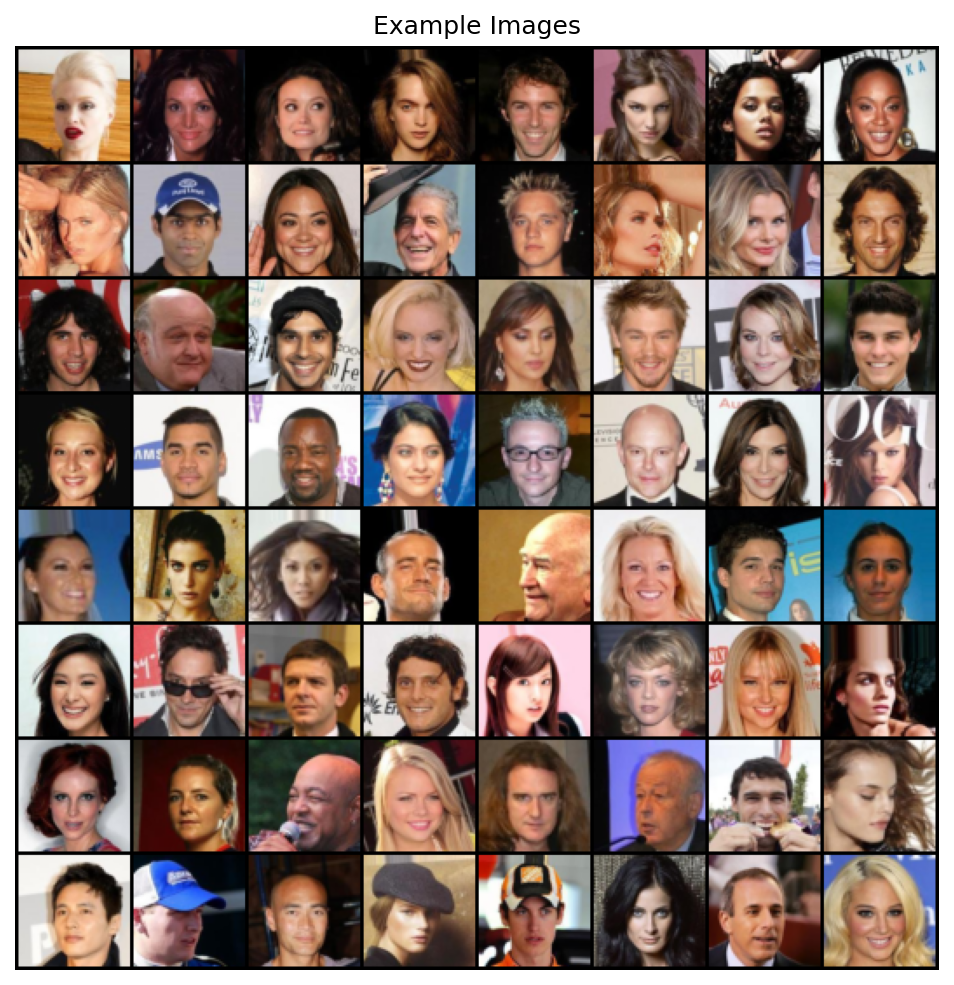

In [5]:
dataset = dset.ImageFolder(root='celebA_10k',
                           transform=transforms.Compose([
                               transforms.Resize(64), # resizing
                               transforms.CenterCrop(64), # crop the image
                               transforms.ToTensor(), # make them Tensors
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)), # to be in range [-1, 1]
                           ]))

# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=128,
                                         shuffle=True, num_workers=2)


# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8), dpi=150)
plt.axis("off")
plt.title("Example Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

# Weight initialization

#### The weights to each layer are initialized from a standard normal distribution with $\mu$ =  0.00 and $\sigma$ = 0.02 , instead of a uniform random number distribution. ( For 'BatchNormalization' , $\mu$ = 1.0 )
#### This is a prescription from : https://arxiv.org/pdf/1511.06434.pdf

In [6]:
# All model weights shall be randomly initialized from a Normal distribution with mean=0, stdev=0.02
# custom weights initialization called on net_G and net_D
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Upsampling
#### To construct an image from latent space $z$, we need to apply upconvolution ( `nn.ConvTranspose2d` ) .
#### Under regular convolution operation, the size of the image is reduced or remains same, where as for upconvolution, the output image has larger size.
#### Nice explanation here - https://towardsdatascience.com/what-is-transposed-convolutional-layer-40e5e6e31c11#:~:text=Transposed%20convolutions%20are%20standard%20convolutions,in%20a%20standard%20convolution%20operation.

# Networks

### Generator

In [7]:
class Generator(nn.Module):
    def __init__(self):
        super().__init__()

        # Number of channels in the training images. For color images this is 3
        nc = 3

        # Size of z latent vector (input noise)
        nz = 100

        # Size of feature maps in generator (channel)
        ngf = 64

        self.main = nn.Sequential(

            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),

            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),

            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),

            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),

            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [8]:
# Create the generator
net_G = Generator().to(device)

# Apply the weights_init function to randomly initialize all weights
net_G.apply(weights_init)

# Print the model
print(net_G)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


### Let's visualize how the upsampling is changing the shape of each intermediate layers

In [9]:
!wget https://www.dropbox.com/s/2h74x4y4oikzdzz/dcgan_gen.png

--2025-04-23 21:20:25--  https://www.dropbox.com/s/2h74x4y4oikzdzz/dcgan_gen.png
Resolving www.dropbox.com (www.dropbox.com)... 162.125.1.18, 2620:100:6017:18::a27d:212
Connecting to www.dropbox.com (www.dropbox.com)|162.125.1.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://www.dropbox.com/scl/fi/o288zdhv7e2a7vx1uemv9/dcgan_gen.png?rlkey=vej4qzuetut8p8zo36ayhmyvi [following]
--2025-04-23 21:20:25--  https://www.dropbox.com/scl/fi/o288zdhv7e2a7vx1uemv9/dcgan_gen.png?rlkey=vej4qzuetut8p8zo36ayhmyvi
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc469ebccae93d0849543aa24c03.dl-eu.dropboxusercontent.com/cd/0/inline/CoZ3AeM9y0lIAa1JIjPnVfjlJy8k1RwPvCXb6-9fuAEYizTptAwYw8zx3BBzZ4cE-fs6cSbAlMYKUr7esQIkw8p3chbJVgqB3wgSoRnircyoruUK5XS4Rw6mejfulS6k9mU8cI62wsZbRXPLxETTn7gN/file# [following]
--2025-04-23 21:20:26--  https://uc469ebccae93d0849543aa24c03.dl-eu.dropboxusercontent.com/cd/0

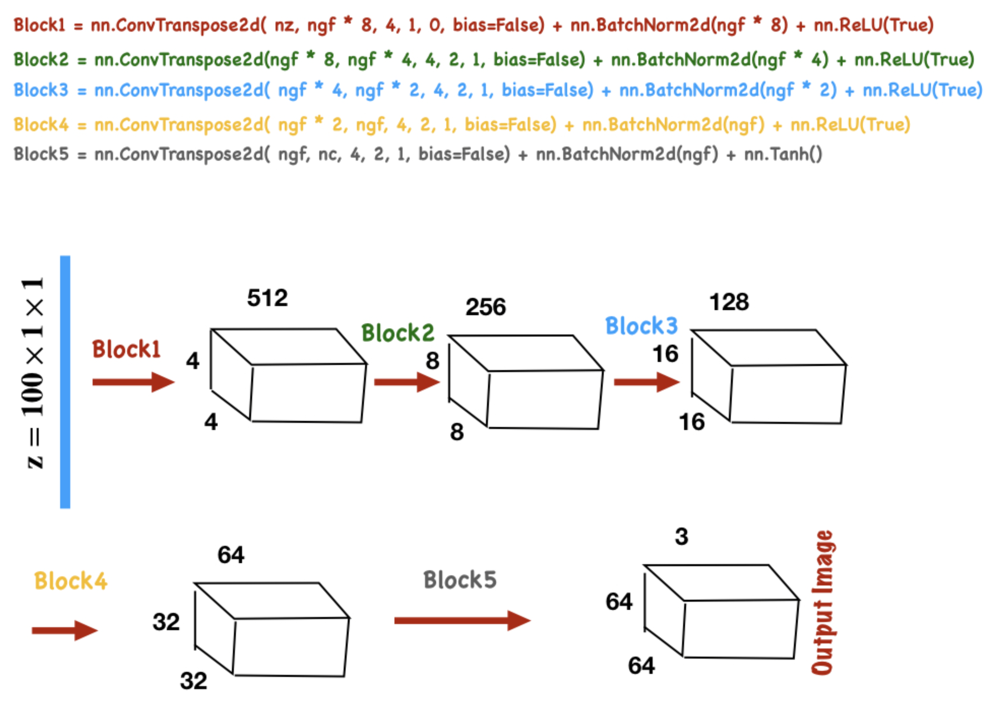

In [10]:
from IPython.display import Image
Image('dcgan_gen.png')

### Discriminator

In [11]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        # Number of channels in the training images. For color images this is 3
        nc = 3

        # Size of z latent vector (i.e. size of generator input)
        nz = 100

        # Size of feature maps in discriminator
        ndf = 64

        self.main = nn.Sequential(

            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [12]:
# Create the Discriminator
net_D = Discriminator().to(device)

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
net_D.apply(weights_init)

# Print the model
print(net_D)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [13]:
# Initialize BCELoss function
loss_fn = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
nz = 100
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizer_D = optim.Adam(net_D.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_G = optim.Adam(net_G.parameters(), lr=0.0002, betas=(0.5, 0.999))

<br><br><br>
# Training loop (A tricky one)

- Train first the Discriminator (`classification`) using
    - Real Data (from celebrity dataset)
    - Fake Data (Created by the Generator)

- Train the generator - the confusing part
    - We'll use the fake the data we generated
    - Change their label to be REAL
    - Compute the Discriminator loss
    - Update the Generator

In [14]:
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
num_epochs = 100

print("Starting Training Loop...")

for epoch in range(num_epochs):

    avg_error_G, avg_error_D = 0, 0
    avg_Dx, avg_DGz1, avg_DGz2 = 0., 0., 0.

    for i, data in enumerate(dataloader, 0):

        # Update the discriminator network

        ## Train with all-real batch
        net_D.zero_grad()

        real_imgs = data[0].to(device)
        b_size = real_imgs.size(0)
        label = torch.full((b_size,), real_label, device=device).float()

        output = net_D(real_imgs).view(-1)

        err_D_real = loss_fn(output, label)
        err_D_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake_imgs = net_G(noise)

        label.fill_(fake_label)
        output = net_D(fake_imgs.detach()).view(-1)

        err_D_fake = loss_fn(output, label)
        err_D_fake.backward()

        err_D = err_D_real + err_D_fake

        # update the discriminator network
        optimizer_D.step()



        # Update the Generator network: maximize log(D(G(z)))
        net_G.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost

        output = net_D(fake_imgs).view(-1)

        err_G = loss_fn(output, label)
        err_G.backward()

        # update the generator network
        optimizer_G.step()


        # computing the average losses and discriminator
        avg_error_G += err_G.item()
        avg_error_D += err_D.item()


        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = net_G(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

    avg_error_G = avg_error_G/len(dataloader.dataset)
    avg_error_D = avg_error_D/len(dataloader.dataset)

    G_losses.append(avg_error_G)
    D_losses.append(avg_error_D)

    if epoch % 10 == 1:
            print(f'{epoch}/{num_epochs}\tLoss_D: {avg_error_D:.4f}\tLoss_G: {avg_error_G:.4f}')


Starting Training Loop...
1/100	Loss_D: 0.0054	Loss_G: 0.1010
11/100	Loss_D: 0.0048	Loss_G: 0.0354
21/100	Loss_D: 0.0047	Loss_G: 0.0326
31/100	Loss_D: 0.0064	Loss_G: 0.0276
41/100	Loss_D: 0.0060	Loss_G: 0.0220
51/100	Loss_D: 0.0068	Loss_G: 0.0229
61/100	Loss_D: 0.0055	Loss_G: 0.0219
71/100	Loss_D: 0.0046	Loss_G: 0.0226
81/100	Loss_D: 0.0040	Loss_G: 0.0245
91/100	Loss_D: 0.0051	Loss_G: 0.0258


### Results : Loss evolution  

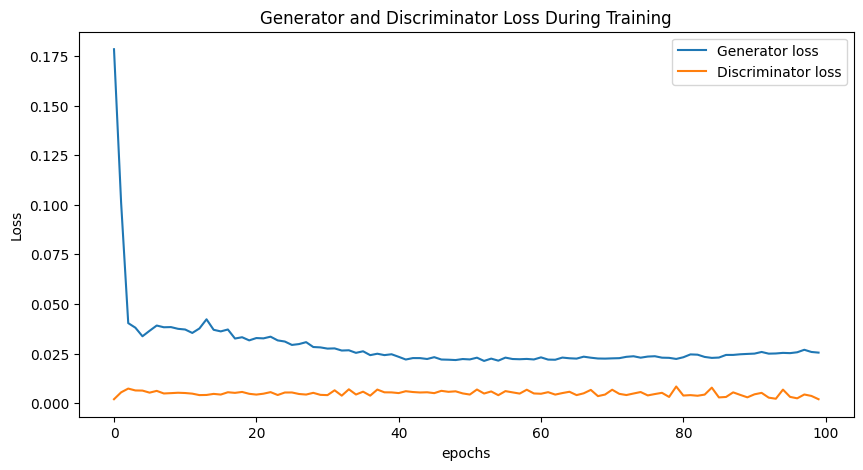

In [15]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="Generator loss")
plt.plot(D_losses,label="Discriminator loss")
plt.xlabel("epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [28]:
# %%capture
# fig = plt.figure(figsize=(8,8))
# plt.axis("off")
# ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
# ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

# display(HTML(ani.to_jshtml() ))

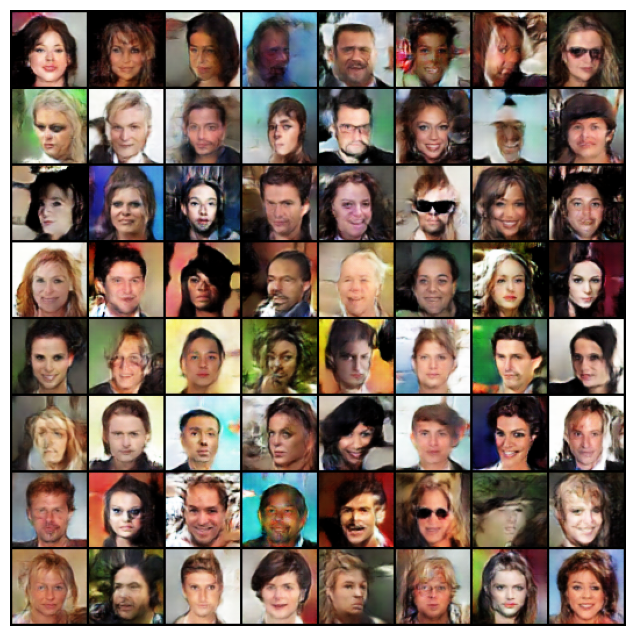

In [29]:
fig = plt.figure(figsize=(8, 8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

# This is the key part for Colab
from IPython.display import display
display(HTML(ani.to_jshtml()))

### Real Vs Fake Images

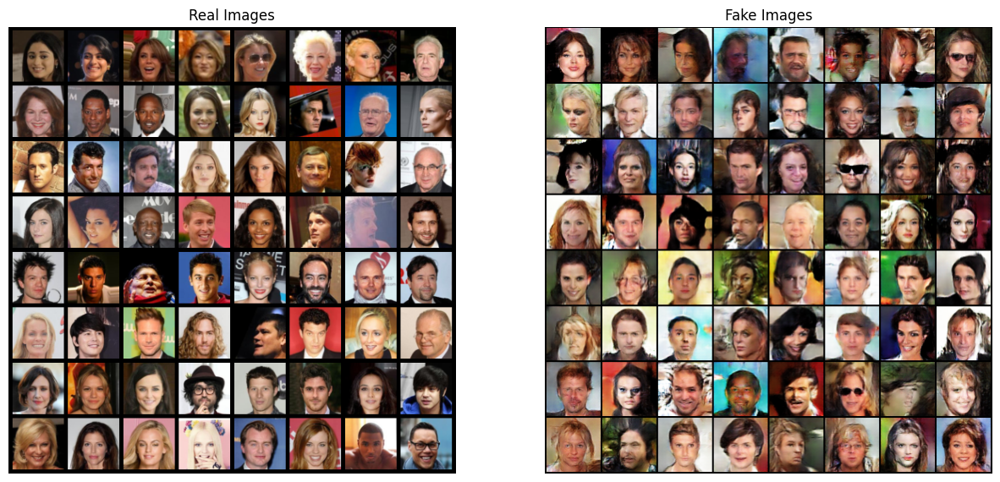

In [17]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()


# Let's generate few fake images and try to find it's nearest image in real list

In [18]:
nz = 100
fixed_noise_new = torch.randn(5, nz, 1, 1, device=device) # --- generating 5 random number each of shape (100 X 1 X 1) ---- #

### For each $z$ we get a $G(z)$

In [19]:
fake_new = net_G(fixed_noise_new).detach().cpu() # --- obtaining five fake images ---- #

### We will use $L1$ distance (  $d = \sum_{i = 1}^{N} | x_i -y_i|$ ) between the real and fake images to estimate closest matching image

In [20]:
loss = nn.L1Loss()

In [21]:
Matched_Index = []

for test_im in range( len(fake_new) ) :
    Nearest_Val, nearest_idx = 999999., -1

    for i_im in range(128) :


      val = loss(fake_new[test_im], real_batch[0].to(device)[i_im].cpu() ).item()

      if(val < Nearest_Val) :
        Nearest_Val = val
        nearest_idx = i_im


    Matched_Index.append(nearest_idx)

In [22]:
Matched_Index

[57, 25, 89, 46, 103]

### Plotting the fake and matched real image

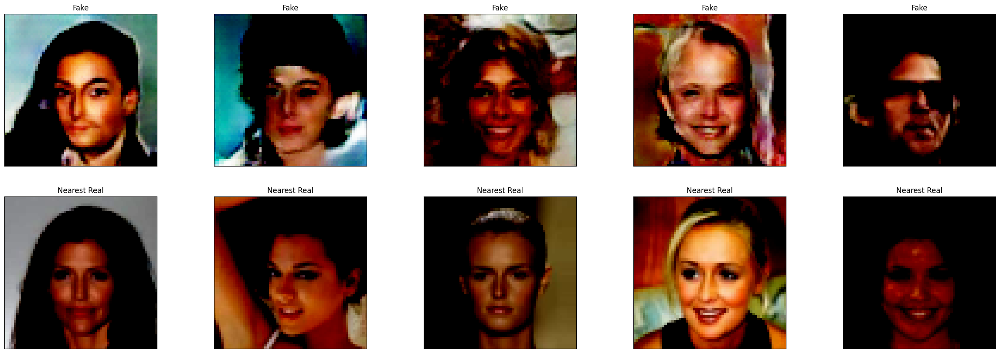

In [23]:
fig = plt.figure(figsize=(30,10))

for idx in np.arange(10):

    ax = fig.add_subplot(2, 5, idx+1, xticks=[], yticks=[])
    if(idx < 5) :
      ax.imshow( np.transpose(fake_new[idx],(1,2,0))  )
      plt.title('Fake')
    else :
      ax.imshow(np.transpose(real_batch[0].to(device)[ Matched_Index[idx-5] ].cpu(),(1,2,0)))
      plt.title('Nearest Real')